## Подготовка данных

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from catboost import CatBoostRegressor
from lightgbm import LGBMRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OrdinalEncoder 
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

In [2]:
def data_about(data):
    """Изучаем общую информацию о датафреймах"""
    display(data.head())
    display(data.info())
    display(data.describe())
    display('Пропуски в датафрейме:',data.isna().sum().sum())

In [3]:
way ='/datasets/final_steel/'

In [4]:
data_arc = pd.read_csv(way + 'data_arc.csv', parse_dates = ['Начало нагрева дугой', 'Конец нагрева дугой'])
data_about(data_arc)

,key,Начало нагрева дугой,Конец нагрева дугой,Активная мощность,Реактивная мощность
0,1,2019-05-03 11:02:14,2019-05-03 11:06:02,0.976059,0.687084
1,1,2019-05-03 11:07:28,2019-05-03 11:10:33,0.805607,0.520285
2,1,2019-05-03 11:11:44,2019-05-03 11:14:36,0.744363,0.498805
3,1,2019-05-03 11:18:14,2019-05-03 11:24:19,1.659363,1.062669
4,1,2019-05-03 11:26:09,2019-05-03 11:28:37,0.692755,0.414397


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14876 entries, 0 to 14875
Data columns (total 5 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   key                   14876 non-null  int64         
 1   Начало нагрева дугой  14876 non-null  datetime64[ns]
 2   Конец нагрева дугой   14876 non-null  datetime64[ns]
 3   Активная мощность     14876 non-null  float64       
 4   Реактивная мощность   14876 non-null  float64       
dtypes: datetime64[ns](2), float64(2), int64(1)
memory usage: 581.2 KB


None

,key,Активная мощность,Реактивная мощность
count,14876.000000,14876.000000,14876.000000
mean,1615.220422,0.670441,0.452592
std,934.571502,0.408159,5.878702
min,1.000000,0.030002,-715.504924
25%,806.000000,0.395297,0.290991
50%,1617.000000,0.555517,0.415962
75%,2429.000000,0.857034,0.637371
max,3241.000000,3.731596,2.676388


'Пропуски в датафрейме:'

0

Отфильтруем выбросы в виде отрицательных значений по столбцу  "Реактивная мощность":

In [5]:
data_arc = data_arc[data_arc['Реактивная мощность']>0]

<Figure size 1008x576 with 0 Axes>

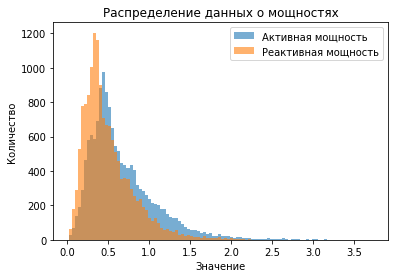

In [6]:
plt.figure(figsize=(14,8))
data_arc[['Активная мощность','Реактивная мощность']].plot(kind='hist', bins=100, legend=True, alpha=0.6)
plt.title('Распределение данных о мощностях')
plt.xlabel('Значение')
plt.ylabel('Количество')
plt.show()

График в целом имеет нормальное распределение со смещенем вправо.

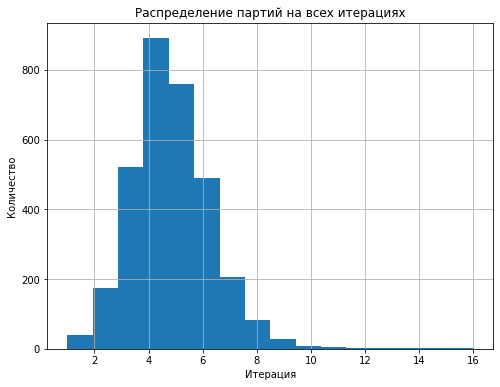

In [7]:
data_arc.groupby('key')['key'].agg('count').hist(figsize=(8,6), bins=16)
plt.title('Распределение партий на всех итерациях')
plt.xlabel('Итерация')
plt.ylabel('Количество')
plt.show()

In [8]:
data_bulk = pd.read_csv(way + 'data_bulk.csv')
data_about(data_bulk)

,key,Bulk 1,Bulk 2,Bulk 3,Bulk 4,Bulk 5,Bulk 6,Bulk 7,Bulk 8,Bulk 9,Bulk 10,Bulk 11,Bulk 12,Bulk 13,Bulk 14,Bulk 15
0,1,NaN,NaN,NaN,43.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,206.0,NaN,150.0,154.0
1,2,NaN,NaN,NaN,73.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,206.0,NaN,149.0,154.0
2,3,NaN,NaN,NaN,34.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,205.0,NaN,152.0,153.0
3,4,NaN,NaN,NaN,81.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,207.0,NaN,153.0,154.0
4,5,NaN,NaN,NaN,78.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,203.0,NaN,151.0,152.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3129 entries, 0 to 3128
Data columns (total 16 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   key      3129 non-null   int64  
 1   Bulk 1   252 non-null    float64
 2   Bulk 2   22 non-null     float64
 3   Bulk 3   1298 non-null   float64
 4   Bulk 4   1014 non-null   float64
 5   Bulk 5   77 non-null     float64
 6   Bulk 6   576 non-null    float64
 7   Bulk 7   25 non-null     float64
 8   Bulk 8   1 non-null      float64
 9   Bulk 9   19 non-null     float64
 10  Bulk 10  176 non-null    float64
 11  Bulk 11  177 non-null    float64
 12  Bulk 12  2450 non-null   float64
 13  Bulk 13  18 non-null     float64
 14  Bulk 14  2806 non-null   float64
 15  Bulk 15  2248 non-null   float64
dtypes: float64(15), int64(1)
memory usage: 391.2 KB


None

,key,Bulk 1,Bulk 2,Bulk 3,Bulk 4,Bulk 5,Bulk 6,Bulk 7,Bulk 8,Bulk 9,Bulk 10,Bulk 11,Bulk 12,Bulk 13,Bulk 14,Bulk 15
count,3129.000000,252.000000,22.000000,1298.000000,1014.000000,77.000000,576.000000,25.000000,1.0,19.000000,176.000000,177.000000,2450.000000,18.000000,2806.000000,2248.000000
mean,1624.383509,39.242063,253.045455,113.879045,104.394477,107.025974,118.925347,305.600000,49.0,76.315789,83.284091,76.819209,260.471020,181.111111,170.284747,160.513345
std,933.337642,18.277654,21.180578,75.483494,48.184126,81.790646,72.057776,191.022904,NaN,21.720581,26.060347,59.655365,120.649269,46.088009,65.868652,51.765319
min,1.000000,10.000000,228.000000,6.000000,12.000000,11.000000,17.000000,47.000000,49.0,63.000000,24.000000,8.000000,53.000000,151.000000,16.000000,1.000000
25%,816.000000,27.000000,242.000000,58.000000,72.000000,70.000000,69.750000,155.000000,49.0,66.000000,64.000000,25.000000,204.000000,153.250000,119.000000,105.000000
50%,1622.000000,31.000000,251.500000,97.500000,102.000000,86.000000,100.000000,298.000000,49.0,68.000000,86.500000,64.000000,208.000000,155.500000,151.000000,160.000000
75%,2431.000000,46.000000,257.750000,152.000000,133.000000,132.000000,157.000000,406.000000,49.0,70.500000,102.000000,106.000000,316.000000,203.500000,205.750000,205.000000
max,3241.000000,185.000000,325.000000,454.000000,281.000000,603.000000,503.000000,772.000000,49.0,147.000000,159.000000,313.000000,1849.000000,305.000000,636.000000,405.000000


'Пропуски в датафрейме:'

35776

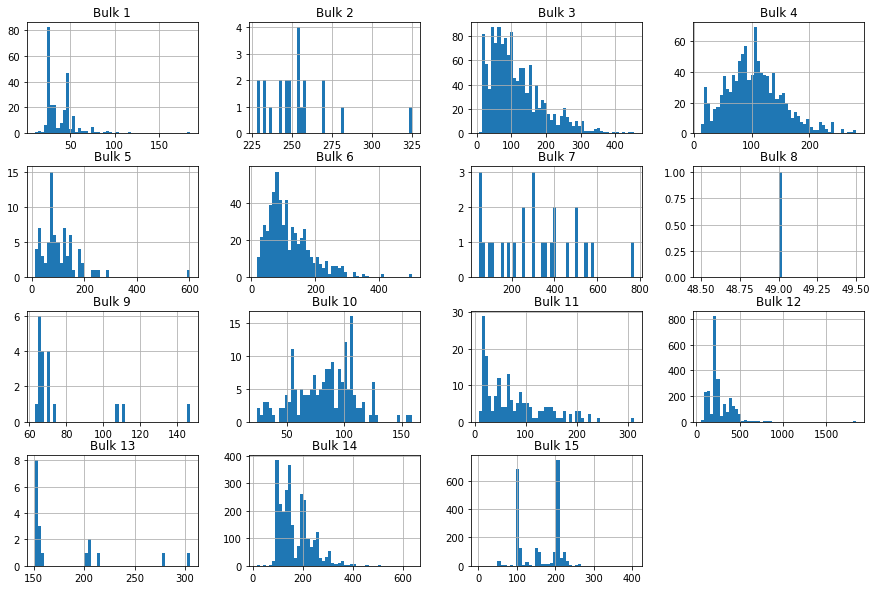

In [9]:
data_bulk[['Bulk 1','Bulk 2','Bulk 3','Bulk 4','Bulk 5','Bulk 6','Bulk 7','Bulk 8','Bulk 9',
           'Bulk 10','Bulk 11','Bulk 12','Bulk 13','Bulk 14','Bulk 15']].hist(figsize=(15,10),bins=50)
plt.show() 

Графики по признаку Bulk 4 имеет нормальное распределение. По Bulk 3 и Bulk 6 график смещен, но в целом тоже имеет нормальное распределение.

In [10]:
data_bulk_time = pd.read_csv(way + 'data_bulk_time.csv', parse_dates = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15])
data_about(data_bulk_time)

,key,Bulk 1,Bulk 2,Bulk 3,Bulk 4,Bulk 5,Bulk 6,Bulk 7,Bulk 8,Bulk 9,Bulk 10,Bulk 11,Bulk 12,Bulk 13,Bulk 14,Bulk 15
0,1,NaT,NaT,NaT,2019-05-03 11:21:30,NaT,NaT,NaT,NaT,NaT,NaT,NaT,2019-05-03 11:03:52,NaT,2019-05-03 11:03:52,2019-05-03 11:03:52
1,2,NaT,NaT,NaT,2019-05-03 11:46:38,NaT,NaT,NaT,NaT,NaT,NaT,NaT,2019-05-03 11:40:20,NaT,2019-05-03 11:40:20,2019-05-03 11:40:20
2,3,NaT,NaT,NaT,2019-05-03 12:31:06,NaT,NaT,NaT,NaT,NaT,NaT,NaT,2019-05-03 12:09:40,NaT,2019-05-03 12:09:40,2019-05-03 12:09:40
3,4,NaT,NaT,NaT,2019-05-03 12:48:43,NaT,NaT,NaT,NaT,NaT,NaT,NaT,2019-05-03 12:41:24,NaT,2019-05-03 12:41:24,2019-05-03 12:41:24
4,5,NaT,NaT,NaT,2019-05-03 13:18:50,NaT,NaT,NaT,NaT,NaT,NaT,NaT,2019-05-03 13:12:56,NaT,2019-05-03 13:12:56,2019-05-03 13:12:56


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3129 entries, 0 to 3128
Data columns (total 16 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   key      3129 non-null   int64         
 1   Bulk 1   252 non-null    datetime64[ns]
 2   Bulk 2   22 non-null     datetime64[ns]
 3   Bulk 3   1298 non-null   datetime64[ns]
 4   Bulk 4   1014 non-null   datetime64[ns]
 5   Bulk 5   77 non-null     datetime64[ns]
 6   Bulk 6   576 non-null    datetime64[ns]
 7   Bulk 7   25 non-null     datetime64[ns]
 8   Bulk 8   1 non-null      datetime64[ns]
 9   Bulk 9   19 non-null     datetime64[ns]
 10  Bulk 10  176 non-null    datetime64[ns]
 11  Bulk 11  177 non-null    datetime64[ns]
 12  Bulk 12  2450 non-null   datetime64[ns]
 13  Bulk 13  18 non-null     datetime64[ns]
 14  Bulk 14  2806 non-null   datetime64[ns]
 15  Bulk 15  2248 non-null   datetime64[ns]
dtypes: datetime64[ns](15), int64(1)
memory usage: 391.2 KB


None

,key
count,3129.000000
mean,1624.383509
std,933.337642
min,1.000000
25%,816.000000
50%,1622.000000
75%,2431.000000
max,3241.000000


'Пропуски в датафрейме:'

35776

Сыпучие материалы добавлялись не во все партии, всего партий в таблице посчитано 3129, а номер максимальной 3241. Пропуски можно заменить нулями.

In [11]:
data_gas = pd.read_csv(way + 'data_gas.csv')
data_about(data_gas)

,key,Газ 1
0,1,29.749986
1,2,12.555561
2,3,28.554793
3,4,18.841219
4,5,5.413692


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3239 entries, 0 to 3238
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   key     3239 non-null   int64  
 1   Газ 1   3239 non-null   float64
dtypes: float64(1), int64(1)
memory usage: 50.7 KB


None

,key,Газ 1
count,3239.000000,3239.000000
mean,1621.861377,11.002062
std,935.386334,6.220327
min,1.000000,0.008399
25%,812.500000,7.043089
50%,1622.000000,9.836267
75%,2431.500000,13.769915
max,3241.000000,77.995040


'Пропуски в датафрейме:'

0

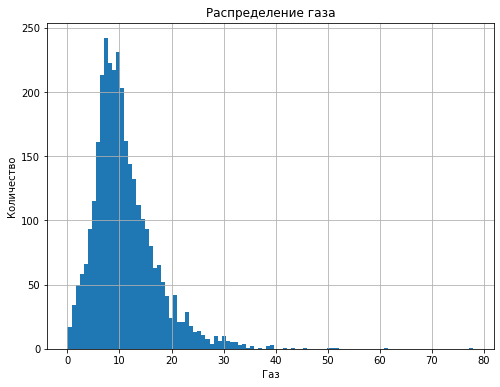

In [12]:
data_gas['Газ 1'].hist(figsize=(8,6), bins=100)
plt.title('Распределение газа')
plt.xlabel('Газ')
plt.ylabel('Количество')
plt.show()

График газа имеет нормальное распределение со смещением вправою. Видны выбросы в диапазоне 40-80. По двум партиям отсутствуют данные о продувке сплава газом. Их стоит удалить.

In [13]:
data_gas = data_gas.dropna(subset=['Газ 1'])

In [14]:
data_temp = pd.read_csv(way + 'data_temp.csv', parse_dates = [1])
data_about(data_temp)

,key,Время замера,Температура
0,1,2019-05-03 11:16:18,1571.0
1,1,2019-05-03 11:25:53,1604.0
2,1,2019-05-03 11:29:11,1618.0
3,1,2019-05-03 11:30:01,1601.0
4,1,2019-05-03 11:30:39,1613.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15907 entries, 0 to 15906
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   key           15907 non-null  int64         
 1   Время замера  15907 non-null  datetime64[ns]
 2   Температура   13006 non-null  float64       
dtypes: datetime64[ns](1), float64(1), int64(1)
memory usage: 372.9 KB


None

,key,Температура
count,15907.000000,13006.000000
mean,1607.880870,1591.840920
std,942.212073,21.375851
min,1.000000,1191.000000
25%,790.000000,1581.000000
50%,1618.000000,1591.000000
75%,2427.000000,1601.000000
max,3241.000000,1705.000000


'Пропуски в датафрейме:'

2901

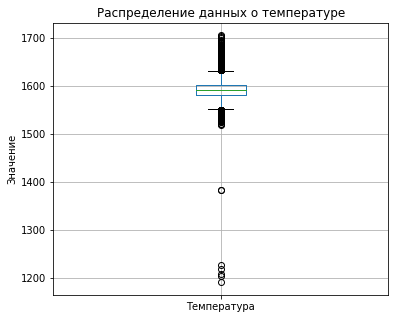

In [15]:
plt.figure(figsize=(6,5))
data_temp.boxplot(['Температура'])
plt.title('Распределение данных о температуре')
plt.ylabel('Значение')
plt.show()

Минимальная температура равна 1191°C это существенная разница по сровнению со средней. 

Отфильтруем значения, которые меньше 1500°C:

In [16]:
data_temp = data_temp[data_temp['Температура']>1500]

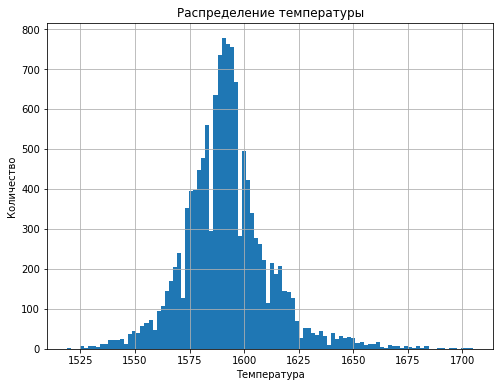

In [17]:
data_temp['Температура'].hist(figsize=(8,6), bins=100)
plt.title('Распределение температуры')
plt.xlabel('Температура')
plt.ylabel('Количество')
plt.show()

График распределения температцры в целом нормальный, имеет небольшой хвост.

In [18]:
data_wire = pd.read_csv(way + 'data_wire.csv')
data_about(data_wire)

,key,Wire 1,Wire 2,Wire 3,Wire 4,Wire 5,Wire 6,Wire 7,Wire 8,Wire 9
0,1,60.059998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,96.052315,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3,91.160157,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4,89.063515,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,89.238236,9.11456,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3081 entries, 0 to 3080
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   key     3081 non-null   int64  
 1   Wire 1  3055 non-null   float64
 2   Wire 2  1079 non-null   float64
 3   Wire 3  63 non-null     float64
 4   Wire 4  14 non-null     float64
 5   Wire 5  1 non-null      float64
 6   Wire 6  73 non-null     float64
 7   Wire 7  11 non-null     float64
 8   Wire 8  19 non-null     float64
 9   Wire 9  29 non-null     float64
dtypes: float64(9), int64(1)
memory usage: 240.8 KB


None

,key,Wire 1,Wire 2,Wire 3,Wire 4,Wire 5,Wire 6,Wire 7,Wire 8,Wire 9
count,3081.000000,3055.000000,1079.000000,63.000000,14.000000,1.000,73.000000,11.000000,19.000000,29.000000
mean,1623.426485,100.895853,50.577323,189.482681,57.442841,15.132,48.016974,10.039007,53.625193,34.155752
std,932.996726,42.012518,39.320216,99.513444,28.824667,NaN,33.919845,8.610584,16.881728,19.931616
min,1.000000,1.918800,0.030160,0.144144,24.148801,15.132,0.034320,0.234208,45.076721,4.622800
25%,823.000000,72.115684,20.193680,95.135044,40.807002,15.132,25.053600,6.762756,46.094879,22.058401
50%,1619.000000,100.158234,40.142956,235.194977,45.234282,15.132,42.076324,9.017009,46.279999,30.066399
75%,2434.000000,126.060483,70.227558,276.252014,76.124619,15.132,64.212723,11.886057,48.089603,43.862003
max,3241.000000,330.314424,282.780152,385.008668,113.231044,15.132,180.454575,32.847674,102.762401,90.053604


'Пропуски в датафрейме:'

23385

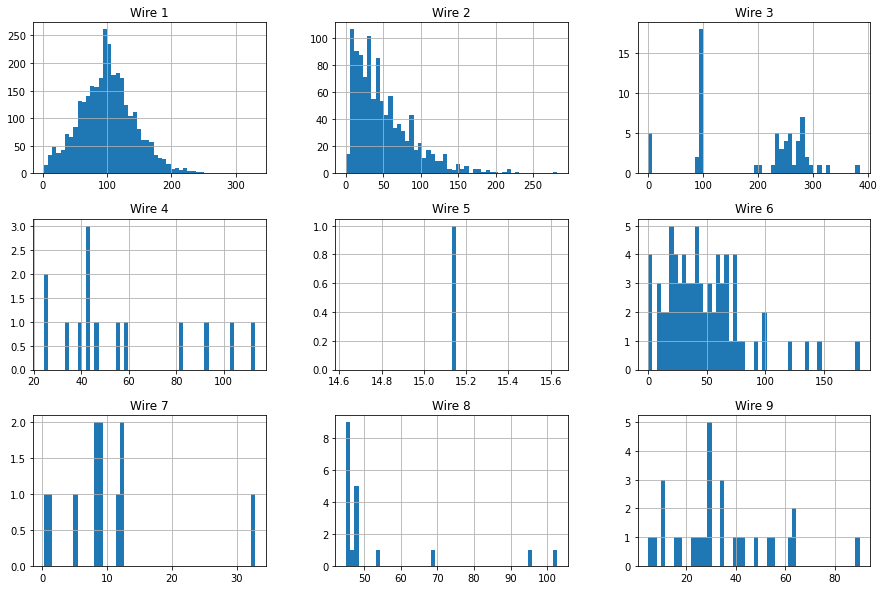

In [19]:
data_wire[['Wire 1', 'Wire 2', 'Wire 3', 'Wire 4', 
           'Wire 5', 'Wire 6', 'Wire 7', 'Wire 8', 'Wire 9']].hist(figsize=(15,10),bins=50)
plt.show() 

Графики по признаку Wire 1 имеет нормальное распределение. По Wire 2 и Wire 6 график смещен, но в целом тоже имеет нормальное распределение. По остальным признам слишком много пропусков.

In [20]:
data_wire_time = pd.read_csv(way + 'data_wire_time.csv', parse_dates = [1,2,3,4,5,6,7,8,9])
data_about(data_wire_time)

,key,Wire 1,Wire 2,Wire 3,Wire 4,Wire 5,Wire 6,Wire 7,Wire 8,Wire 9
0,1,2019-05-03 11:11:41,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
1,2,2019-05-03 11:46:10,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
2,3,2019-05-03 12:13:47,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
3,4,2019-05-03 12:48:05,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
4,5,2019-05-03 13:18:15,2019-05-03 13:32:06,NaT,NaT,NaT,NaT,NaT,NaT,NaT


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3081 entries, 0 to 3080
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   key     3081 non-null   int64         
 1   Wire 1  3055 non-null   datetime64[ns]
 2   Wire 2  1079 non-null   datetime64[ns]
 3   Wire 3  63 non-null     datetime64[ns]
 4   Wire 4  14 non-null     datetime64[ns]
 5   Wire 5  1 non-null      datetime64[ns]
 6   Wire 6  73 non-null     datetime64[ns]
 7   Wire 7  11 non-null     datetime64[ns]
 8   Wire 8  19 non-null     datetime64[ns]
 9   Wire 9  29 non-null     datetime64[ns]
dtypes: datetime64[ns](9), int64(1)
memory usage: 240.8 KB


None

,key
count,3081.000000
mean,1623.426485
std,932.996726
min,1.000000
25%,823.000000
50%,1619.000000
75%,2434.000000
max,3241.000000


'Пропуски в датафрейме:'

23385

Выводы:
1. Во всех датафреймах даты переведены в формат datetime.
2. Выявлены и отфильтрованы выбросы в таблицах: с результами измерения температуры (данные менее 1500°C были отсеяны) и в данных об электродах (удалили отрицательную реактивную мощность).
3. На каждую партию может приходиться до 16 итераций.
4. Не все партии участвуют в добавлении проволоки, сыпучих материалов и продувке газом сплава.
5. Данные с пропусками следуют заменить нулями.

## Расчет дополнительных признаков

In [21]:
data_temp[data_temp['key']==1]

,key,Время замера,Температура
0,1,2019-05-03 11:16:18,1571.0
1,1,2019-05-03 11:25:53,1604.0
2,1,2019-05-03 11:29:11,1618.0
3,1,2019-05-03 11:30:01,1601.0
4,1,2019-05-03 11:30:39,1613.0


In [22]:
data_temp['key'].nunique()

3215

In [23]:
data_temp['key'].max()

3241

In [24]:
data_temp_pivot = data_temp.pivot_table(index='key', aggfunc=['first', 'last'])
data_temp_pivot=data_temp_pivot.reset_index()
data_temp_pivot.columns=['key','Время первого замера','Температура в начале замера','Время последнего замера',
                        'Температура в конце замера']

display(data_temp_pivot.head())
#display(data_temp_pivot.tail())

,key,Время первого замера,Температура в начале замера,Время последнего замера,Температура в конце замера
0,1,2019-05-03 11:16:18,1571.0,2019-05-03 11:30:39,1613.0
1,2,2019-05-03 11:37:27,1581.0,2019-05-03 11:59:12,1602.0
2,3,2019-05-03 12:13:17,1596.0,2019-05-03 12:34:57,1599.0
3,4,2019-05-03 12:52:57,1601.0,2019-05-03 12:59:25,1625.0
4,5,2019-05-03 13:23:19,1576.0,2019-05-03 13:36:01,1602.0


Определим время между первым и последним замером температуры.

In [25]:
data_temp_pivot['Время между замерами, сек.'] = (data_temp_pivot['Время последнего замера'] - data_temp_pivot['Время первого замера']).dt.seconds
len(data_temp_pivot[data_temp_pivot['Время между замерами, сек.']==0])

740

740 партии не имеют целевого признака, их необходимо дропнуть

In [26]:
data_temp_pivot = data_temp_pivot[data_temp_pivot['Время между замерами, сек.']!=0]

In [27]:
data_temp_pivot.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2475 entries, 0 to 2476
Data columns (total 6 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   key                          2475 non-null   int64         
 1   Время первого замера         2475 non-null   datetime64[ns]
 2   Температура в начале замера  2475 non-null   float64       
 3   Время последнего замера      2475 non-null   datetime64[ns]
 4   Температура в конце замера   2475 non-null   float64       
 5   Время между замерами, сек.   2475 non-null   int64         
dtypes: datetime64[ns](2), float64(2), int64(2)
memory usage: 135.4 KB


Определим работу, расчитав общую мощность (корень квадратный из суммы квадратов активной и реактивной) и умножить ее на время.

$$
$$
$S = \sqrt{P^{2} + Q^{2}}$
$$
$$
$A = S*t$

In [28]:
data_arc['Время нагрева электродами'] = (data_arc['Конец нагрева дугой']-data_arc['Начало нагрева дугой']).dt.seconds

In [29]:
#data_arc_sum = data_arc.groupby('key').agg(t = ('Время нагрева электродами', 'sum'), P = ('Активная мощность', 'sum'),
                                       #    Q = ('Реактивная мощность', 'sum'))
#data_arc_sum['Общая мощность'] = np.sqrt(data_arc_sum['P']**2 + data_arc_sum['Q']**2)
#for key in data_arc_sum.index:
     # data_arc_sum['Работа'] = data_arc_sum['Общая мощность'] * data_arc_sum['t'].loc[key]
#data_arc_sum

In [30]:
data_arc['Общая мощность'] = np.sqrt(data_arc['Активная мощность']**2 + data_arc['Реактивная мощность']**2)


In [31]:
for key in data_arc.index:
      data_arc['Работа'] = data_arc['Общая мощность'] * data_arc['Время нагрева электродами'].loc[key]
data_arc

,key,Начало нагрева дугой,Конец нагрева дугой,Активная мощность,Реактивная мощность,Время нагрева электродами,Общая мощность,Работа
0,1,2019-05-03 11:02:14,2019-05-03 11:06:02,0.976059,0.687084,228,1.193639,96.684781
1,1,2019-05-03 11:07:28,2019-05-03 11:10:33,0.805607,0.520285,185,0.959010,77.679782
2,1,2019-05-03 11:11:44,2019-05-03 11:14:36,0.744363,0.498805,172,0.896038,72.579062
3,1,2019-05-03 11:18:14,2019-05-03 11:24:19,1.659363,1.062669,365,1.970470,159.608035
4,1,2019-05-03 11:26:09,2019-05-03 11:28:37,0.692755,0.414397,148,0.807239,65.386329
...,...,...,...,...,...,...,...,...
14871,3241,2019-09-01 03:58:58,2019-09-01 04:01:35,0.533670,0.354439,157,0.640648,51.892498
14872,3241,2019-09-01 04:05:04,2019-09-01 04:08:04,0.676604,0.523631,180,0.855559,69.300307
14873,3241,2019-09-01 04:16:41,2019-09-01 04:19:45,0.733899,0.475654,184,0.874560,70.839343
14874,3241,2019-09-01 04:31:51,2019-09-01 04:32:48,0.220694,0.145768,57,0.264489,21.423581


In [32]:
data_arc = data_arc.groupby('key').agg(t = ('Время нагрева электродами', 'sum'), P = ('Активная мощность', 'mean'),
                                           Q = ('Реактивная мощность', 'mean'),  S = ('Общая мощность', 'mean'),
                                      A = ('Работа', 'sum'))
data_arc

,t,P,Q,S,A
key,,,,,
1,1098,0.975629,0.636648,1.165279,471.937990
2,811,0.763150,0.499528,0.912304,295.586528
3,655,0.505176,0.319815,0.597907,242.152267
4,741,0.802313,0.515074,0.953741,309.011952
5,869,0.836793,0.563161,1.008939,326.896384
...,...,...,...,...,...
3237,909,0.786493,0.565692,0.968996,392.443575
3238,546,0.702176,0.560394,0.898847,218.419908
3239,1216,0.583344,0.388952,0.701485,454.562492


In [33]:
#data_arc['Активная мощность'] = data_arc['Активная мощность'] * data_arc['Время нагрева электродами']
#data_arc['Реактивная мощность'] = data_arc['Реактивная мощность'] * data_arc['Время нагрева электродами']

In [34]:
#data_arc = data_arc.groupby('key').agg({'Начало нагрева дугой':'min', 'Активная мощность' : 'sum', 
                                        #'Реактивная мощность' : 'sum'})
#data_arc

Удалим неинформативные признаки и заполним пропуски нулями.

In [35]:
data_wire.drop('Wire 5', axis=1, inplace=True)
data_bulk_time.drop('Bulk 8', axis=1, inplace=True)
data_bulk.drop('Bulk 8', axis=1, inplace=True)

data_bulk = data_bulk.fillna(0)
data_bulk_time = data_bulk_time.fillna(0)
data_wire = data_wire.fillna(0)

## Объединение таблиц

In [36]:
data = data_temp_pivot.merge(data_arc, on='key', how='inner')
data

,key,Время первого замера,Температура в начале замера,Время последнего замера,Температура в конце замера,"Время между замерами, сек.",t,P,Q,S,A
0,1,2019-05-03 11:16:18,1571.0,2019-05-03 11:30:39,1613.0,861,1098,0.975629,0.636648,1.165279,471.937990
1,2,2019-05-03 11:37:27,1581.0,2019-05-03 11:59:12,1602.0,1305,811,0.763150,0.499528,0.912304,295.586528
2,3,2019-05-03 12:13:17,1596.0,2019-05-03 12:34:57,1599.0,1300,655,0.505176,0.319815,0.597907,242.152267
3,4,2019-05-03 12:52:57,1601.0,2019-05-03 12:59:25,1625.0,388,741,0.802313,0.515074,0.953741,309.011952
4,5,2019-05-03 13:23:19,1576.0,2019-05-03 13:36:01,1602.0,762,869,0.836793,0.563161,1.008939,326.896384
...,...,...,...,...,...,...,...,...,...,...,...
2470,2495,2019-08-06 00:35:45,1570.0,2019-08-06 00:54:42,1591.0,1137,723,0.802673,0.590194,0.996717,322.936349
2471,2496,2019-08-06 01:02:54,1554.0,2019-08-06 01:29:52,1591.0,1618,940,0.700511,0.468364,0.842839,409.619668
2472,2497,2019-08-06 01:41:53,1571.0,2019-08-06 01:53:50,1589.0,717,569,0.737460,0.617090,0.961672,233.686363
2473,2498,2019-08-06 02:03:49,1591.0,2019-08-06 02:25:31,1594.0,1302,750,0.681745,0.471086,0.828750,335.643656


In [37]:
data = data.merge(data_gas, on='key', how='inner')
data

,key,Время первого замера,Температура в начале замера,Время последнего замера,Температура в конце замера,"Время между замерами, сек.",t,P,Q,S,A,Газ 1
0,1,2019-05-03 11:16:18,1571.0,2019-05-03 11:30:39,1613.0,861,1098,0.975629,0.636648,1.165279,471.937990,29.749986
1,2,2019-05-03 11:37:27,1581.0,2019-05-03 11:59:12,1602.0,1305,811,0.763150,0.499528,0.912304,295.586528,12.555561
2,3,2019-05-03 12:13:17,1596.0,2019-05-03 12:34:57,1599.0,1300,655,0.505176,0.319815,0.597907,242.152267,28.554793
3,4,2019-05-03 12:52:57,1601.0,2019-05-03 12:59:25,1625.0,388,741,0.802313,0.515074,0.953741,309.011952,18.841219
4,5,2019-05-03 13:23:19,1576.0,2019-05-03 13:36:01,1602.0,762,869,0.836793,0.563161,1.008939,326.896384,5.413692
...,...,...,...,...,...,...,...,...,...,...,...,...
2468,2495,2019-08-06 00:35:45,1570.0,2019-08-06 00:54:42,1591.0,1137,723,0.802673,0.590194,0.996717,322.936349,7.125735
2469,2496,2019-08-06 01:02:54,1554.0,2019-08-06 01:29:52,1591.0,1618,940,0.700511,0.468364,0.842839,409.619668,9.412616
2470,2497,2019-08-06 01:41:53,1571.0,2019-08-06 01:53:50,1589.0,717,569,0.737460,0.617090,0.961672,233.686363,6.271699
2471,2498,2019-08-06 02:03:49,1591.0,2019-08-06 02:25:31,1594.0,1302,750,0.681745,0.471086,0.828750,335.643656,14.953657


In [38]:
data = data.merge(data_wire, on='key', how='inner')

In [39]:
data = data.merge(data_bulk, on='key', how='inner')

In [40]:
data_about(data)

,key,Время первого замера,Температура в начале замера,Время последнего замера,Температура в конце замера,"Время между замерами, сек.",t,P,Q,S,...,Bulk 5,Bulk 6,Bulk 7,Bulk 9,Bulk 10,Bulk 11,Bulk 12,Bulk 13,Bulk 14,Bulk 15
0,1,2019-05-03 11:16:18,1571.0,2019-05-03 11:30:39,1613.0,861,1098,0.975629,0.636648,1.165279,...,0.0,0.0,0.0,0.0,0.0,0.0,206.0,0.0,150.0,154.0
1,2,2019-05-03 11:37:27,1581.0,2019-05-03 11:59:12,1602.0,1305,811,0.763150,0.499528,0.912304,...,0.0,0.0,0.0,0.0,0.0,0.0,206.0,0.0,149.0,154.0
2,3,2019-05-03 12:13:17,1596.0,2019-05-03 12:34:57,1599.0,1300,655,0.505176,0.319815,0.597907,...,0.0,0.0,0.0,0.0,0.0,0.0,205.0,0.0,152.0,153.0
3,4,2019-05-03 12:52:57,1601.0,2019-05-03 12:59:25,1625.0,388,741,0.802313,0.515074,0.953741,...,0.0,0.0,0.0,0.0,0.0,0.0,207.0,0.0,153.0,154.0
4,5,2019-05-03 13:23:19,1576.0,2019-05-03 13:36:01,1602.0,762,869,0.836793,0.563161,1.008939,...,0.0,0.0,0.0,0.0,0.0,0.0,203.0,0.0,151.0,152.0


<class 'pandas.core.frame.DataFrame'>
Int64Index: 2329 entries, 0 to 2328
Data columns (total 34 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   key                          2329 non-null   int64         
 1   Время первого замера         2329 non-null   datetime64[ns]
 2   Температура в начале замера  2329 non-null   float64       
 3   Время последнего замера      2329 non-null   datetime64[ns]
 4   Температура в конце замера   2329 non-null   float64       
 5   Время между замерами, сек.   2329 non-null   int64         
 6   t                            2329 non-null   int64         
 7   P                            2329 non-null   float64       
 8   Q                            2329 non-null   float64       
 9   S                            2329 non-null   float64       
 10  A                            2329 non-null   float64       
 11  Газ 1                        2329 non-null 

None

,key,Температура в начале замера,Температура в конце замера,"Время между замерами, сек.",t,P,Q,S,A,Газ 1,...,Bulk 5,Bulk 6,Bulk 7,Bulk 9,Bulk 10,Bulk 11,Bulk 12,Bulk 13,Bulk 14,Bulk 15
count,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000,...,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000,2329.000000
mean,1251.832546,1587.386003,1593.365393,1898.290253,807.600687,0.669044,0.499276,0.836618,319.275840,11.375600,...,2.640189,22.430228,2.004723,0.444826,5.052812,4.245170,208.415629,1.067411,153.853585,119.952769
std,714.762400,23.619841,11.200915,1322.054556,340.897332,0.196943,0.147383,0.242350,144.140948,6.392041,...,22.402293,55.790873,30.676234,6.220641,20.917800,22.515487,157.062272,14.235055,81.404354,84.640443
min,1.000000,1519.000000,1541.000000,234.000000,57.000000,0.186226,0.130062,0.228541,20.868610,0.008399,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,630.000000,1571.000000,1587.000000,1215.000000,581.000000,0.526430,0.392506,0.659957,221.541497,7.282948,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,105.000000,0.000000,105.000000,0.000000
50%,1255.000000,1587.000000,1593.000000,1634.000000,778.000000,0.644404,0.487685,0.815558,305.661861,10.100950,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,206.000000,0.000000,149.000000,107.000000
75%,1868.000000,1603.000000,1598.000000,2290.000000,993.000000,0.792065,0.592351,0.986384,396.316077,14.216688,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,282.000000,0.000000,204.000000,204.000000
max,2499.000000,1660.000000,1653.000000,23537.000000,4189.000000,1.421416,1.134983,1.796257,1746.746474,77.995040,...,603.000000,503.000000,772.000000,147.000000,159.000000,313.000000,1849.000000,305.000000,636.000000,405.000000


'Пропуски в датафрейме:'

0

Заменим провуски нулями.

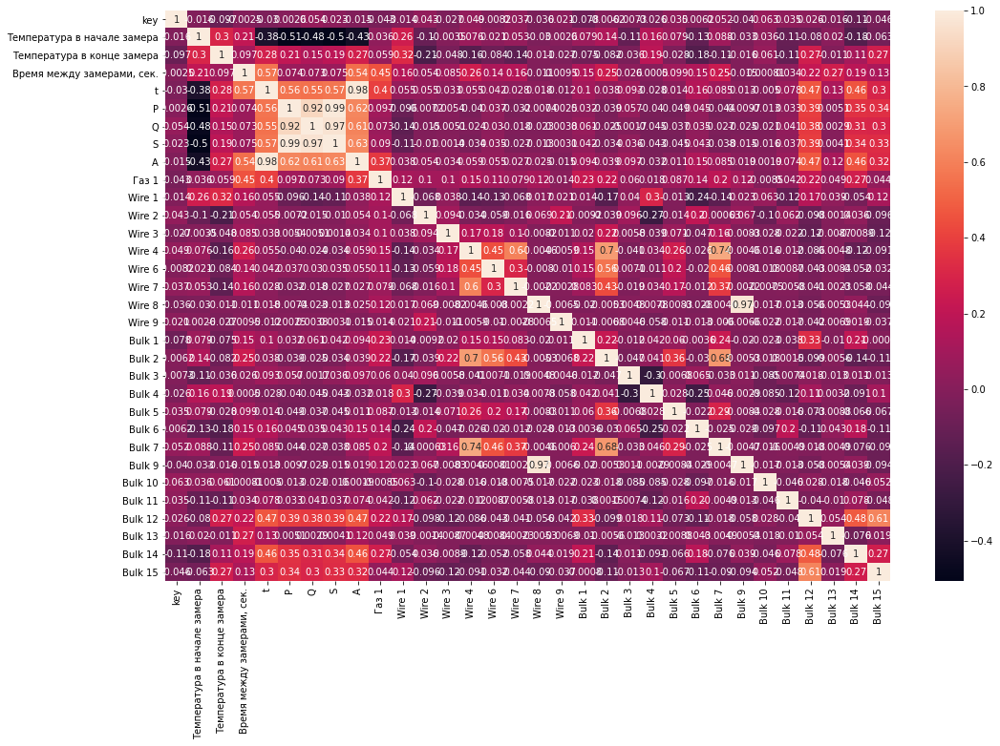

In [42]:
#Построение корреляционной матрицы
plt.figure(figsize = (17,11))
corr_matrix = sns.heatmap(data.corr(), annot=True)
plt.show()

Прослеживается сильная связь между признаками Wire 8 и Bulk 9, и t, P, Q, S, A 0.92-0.98.

In [43]:
data1 = data.drop(['Wire 8','t', 'P', 'Q', 'S'], axis = 1)

In [44]:
data1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2329 entries, 0 to 2328
Data columns (total 29 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   key                          2329 non-null   int64         
 1   Время первого замера         2329 non-null   datetime64[ns]
 2   Температура в начале замера  2329 non-null   float64       
 3   Время последнего замера      2329 non-null   datetime64[ns]
 4   Температура в конце замера   2329 non-null   float64       
 5   Время между замерами, сек.   2329 non-null   int64         
 6   A                            2329 non-null   float64       
 7   Газ 1                        2329 non-null   float64       
 8   Wire 1                       2329 non-null   float64       
 9   Wire 2                       2329 non-null   float64       
 10  Wire 3                       2329 non-null   float64       
 11  Wire 4                       2329 non-null 

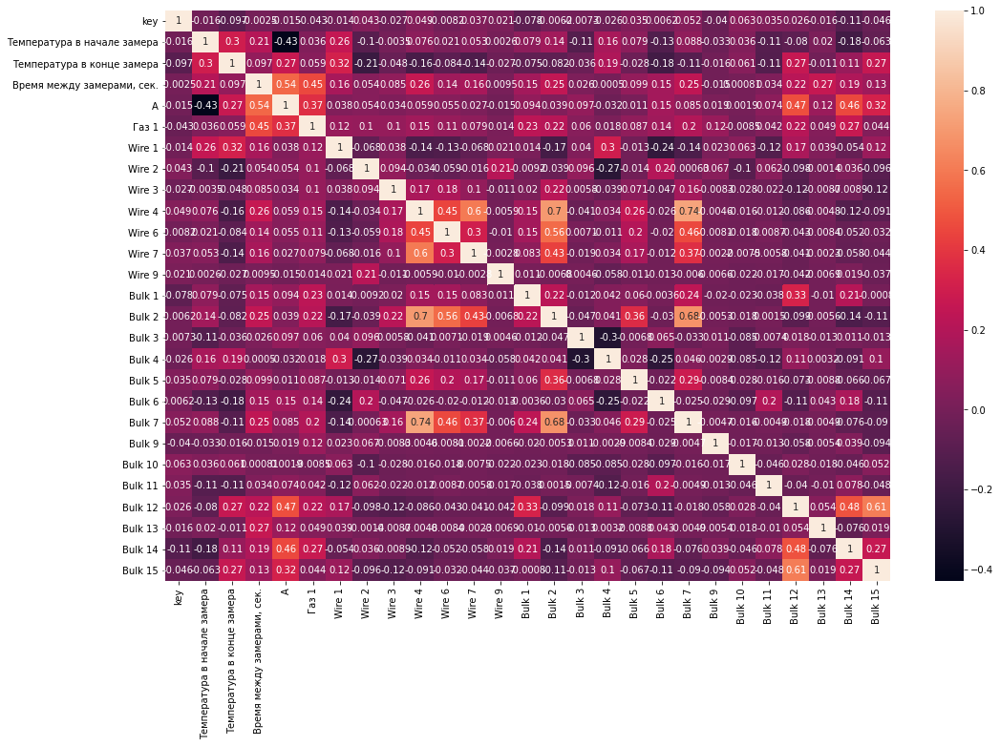

In [45]:
plt.figure(figsize=(17,11))
corr_matrix = sns.heatmap(data1.corr(), annot=True)
plt.show()

## Разбиение датафрейма на обучающую и тестовую выборки

Разобьем датасет на три выборки: обучающуюи и тестовую, и сохраним признаки в переменные

In [46]:
df = data1.drop(['key','Время последнего замера',
                             'Время первого замера','Время между замерами, сек.'], axis = 1)

In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2329 entries, 0 to 2328
Data columns (total 25 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Температура в начале замера  2329 non-null   float64
 1   Температура в конце замера   2329 non-null   float64
 2   A                            2329 non-null   float64
 3   Газ 1                        2329 non-null   float64
 4   Wire 1                       2329 non-null   float64
 5   Wire 2                       2329 non-null   float64
 6   Wire 3                       2329 non-null   float64
 7   Wire 4                       2329 non-null   float64
 8   Wire 6                       2329 non-null   float64
 9   Wire 7                       2329 non-null   float64
 10  Wire 9                       2329 non-null   float64
 11  Bulk 1                       2329 non-null   float64
 12  Bulk 2                       2329 non-null   float64
 13  Bulk 3            

In [48]:
train, test = train_test_split(df, test_size=0.25, random_state=80822)

In [49]:
features_train = train.drop(['Температура в конце замера'], axis=1)
target_train= train['Температура в конце замера']
features_test = test.drop(['Температура в конце замера'], axis=1)
target_test = test['Температура в конце замера']
print(features_train.shape)
print(target_train.shape)
print(features_test.shape)
print(target_test.shape)

(1746, 24)
(1746,)
(583, 24)
(583,)


In [50]:
df1 = data.drop(['key','Время последнего замера',
                             'Время первого замера','Время между замерами, сек.'], axis = 1)

In [51]:
train, test = train_test_split(df1, test_size=0.25, random_state=80822)

In [52]:
features_train_cor = train.drop(['Температура в конце замера'], axis=1)
target_train_cor= train['Температура в конце замера']
features_test_cor = test.drop(['Температура в конце замера'], axis=1)
target_test_cor = test['Температура в конце замера']
print(features_train_cor.shape)
print(target_train_cor.shape)
print(features_test_cor.shape)
print(target_test_cor.shape)

(1746, 29)
(1746,)
(583, 29)
(583,)


In [53]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2329 entries, 0 to 2328
Data columns (total 30 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Температура в начале замера  2329 non-null   float64
 1   Температура в конце замера   2329 non-null   float64
 2   t                            2329 non-null   int64  
 3   P                            2329 non-null   float64
 4   Q                            2329 non-null   float64
 5   S                            2329 non-null   float64
 6   A                            2329 non-null   float64
 7   Газ 1                        2329 non-null   float64
 8   Wire 1                       2329 non-null   float64
 9   Wire 2                       2329 non-null   float64
 10  Wire 3                       2329 non-null   float64
 11  Wire 4                       2329 non-null   float64
 12  Wire 6                       2329 non-null   float64
 13  Wire 7            

In [54]:
#Масштабирование признаков

#pd.options.mode.chained_assignment = None

#numeric = df.columns.tolist()
#numeric = [i for i in numeric if i not in ('Температура в конце замера')]
#scaler = StandardScaler()
#scaler = MinMaxScaler()
#scaler.fit(train[numeric])
#features_train[numeric] = scaler.transform(features_train[numeric])
#features_test[numeric] = scaler.transform(features_test[numeric])

## Обучение моделей и оценка их качества кросс-валидацией

### Линейная регрессия

In [55]:
%%time

#parametrs = {'fit_intercept': [True],
         #     'normalize': [True, False]}
#model_LR = LinearRegression(normalize=True)
#grid_model_LR = GridSearchCV(model_LR, parametrs, cv=5, random_state=80822, scoring ='neg_mean_absolute_error')
#grid_model_LR.fit(features_train,target_train)


model_LR = LinearRegression(normalize=True)
cv_MAE_LR = (cross_val_score(model_LR, features_train, target_train, cv=5, scoring='neg_mean_absolute_error').mean())

print("MAE на CV:",cv_MAE_LR * -1)

MAE на CV: 6.313660893215989
CPU times: user 154 ms, sys: 195 ms, total: 349 ms
Wall time: 352 ms


### Случайный лес

In [56]:
model_RFR = RandomForestRegressor() 
parametrs_RFR = [{'max_depth': range (1,12),
                'min_samples_leaf': range (1,5),
                'random_state': [80822]}]

grid_model_RFR = GridSearchCV(model_RFR, parametrs_RFR, scoring='neg_mean_absolute_error', cv=5)
grid_model_RFR.fit(features_train_cor,target_train_cor)
print(grid_model_RFR.best_params_)
print("MAE на CV:",grid_model_RFR.best_score_ * -1)

{'max_depth': 11, 'min_samples_leaf': 2, 'random_state': 80822}
MAE на CV: 6.109931672260694


### Градиентный бустинг с CatBoost

In [57]:
%%time

param = {'l2_leaf_reg': range (14, 18, 1),
         'max_depth': range (3, 6, 1),
         'learning_rate': [0.01, 0.02, 0.03]}

model_CBR = CatBoostRegressor(loss_function='MAE', random_state=80822, iterations=2000)
grid_model_CBR = GridSearchCV(model_CBR, param, cv=5, scoring='neg_mean_absolute_error', n_jobs=4, verbose=3)
grid_model_CBR.fit(features_train_cor, target_train_cor)

print(grid_model_CBR.best_params_)
print("MAE на CV:",grid_model_CBR.best_score_ * -1)

Fitting 5 folds for each of 36 candidates, totalling 180 fits
0:	learn: 8.0576781	total: 47.7ms	remaining: 1m 35s
1:	learn: 8.0415785	total: 48.9ms	remaining: 48.9s
2:	learn: 8.0231909	total: 50.1ms	remaining: 33.3s
3:	learn: 8.0151122	total: 51.3ms	remaining: 25.6s
4:	learn: 8.0042786	total: 52.6ms	remaining: 21s
5:	learn: 7.9899470	total: 53.7ms	remaining: 17.9s
6:	learn: 7.9788361	total: 54.9ms	remaining: 15.6s
7:	learn: 7.9687721	total: 56.6ms	remaining: 14.1s
8:	learn: 7.9540184	total: 57.7ms	remaining: 12.8s
9:	learn: 7.9362132	total: 59ms	remaining: 11.7s
10:	learn: 7.9238232	total: 60.1ms	remaining: 10.9s
11:	learn: 7.9188814	total: 61.2ms	remaining: 10.1s
12:	learn: 7.9041665	total: 62.4ms	remaining: 9.53s
13:	learn: 7.8871567	total: 63.5ms	remaining: 9.01s
14:	learn: 7.8705123	total: 64.6ms	remaining: 8.55s
15:	learn: 7.8547475	total: 65.7ms	remaining: 8.15s
16:	learn: 7.8381650	total: 66.8ms	remaining: 7.79s
17:	learn: 7.8247683	total: 68ms	remaining: 7.49s
18:	learn: 7.8121

In [58]:
# сводная таблица результатов

index = ['Линейная регресси',
         'Случайный лес',
         'CatBoost']

data = {'MAE на CV':[cv_MAE_LR * -1,
                    grid_model_RFR.best_score_ * -1,
                    grid_model_CBR.best_score_ * -1]}

result = pd.DataFrame(data=data, index=index)
result

,MAE на CV
Линейная регресси,6.313661
Случайный лес,6.109932
CatBoost,5.854664


In [59]:
predictions_CBR = grid_model_CBR.predict(features_test_cor)
mae_CBR= mean_absolute_error(target_test_cor, predictions_CBR)
print("MAE на тестовой выборке:", mae_CBR)

MAE на тестовой выборке: 5.7465553705051


In [60]:
target = df1['Температура в конце замера']

target_pred_constant = pd.Series([target.mean()]*len(target))

print(mean_absolute_error(target, target_pred_constant))

8.084363508184838


Отличный результат показала модель CatBoost с MAE на тестовых данных равной 5.94, а проверка константной моделью 8.04. Следовательно модель CatBoost можно применять для бизнеса

## Отчет по проведенному исследованию
В ходе работы были выполнены следующие этапы:

1. Исследовательский анализ данных:


- загружена общая описательная информация по таблицам;
- во всех датафреймах даты переведены в формат datetime;
- построены графики распределения признаков;
- отфильтрованы отрицательная реактивная мощность в таблице об электродах;
- две партии, с отсутствующими данными о продувке сплава газом, удалены;
- отфильтрованы значения, которые меньше 1500°C в таблице температур, т.к. это существенная разница по сравнению со средней.

2. Расчет дополнительных признаков:


- составили сводную таблицу с температурой в начале замера и температурой в конце замера по каждой партии;
- удалены 740 партии не имеют целевого признака;
- определена работа (А), как произведение общей мощности (S) и временем нагрева электродами (t);
- удалены неинформативные признаки Wire 5 из проволочных материалов, Bulk 8 из времени  подаче сыпучих материалов и Bulk 8 из объема подаче сыпучих материалов ;
- также указанные выше  таблицы были заполнены нулями.


3. Объединение таблиц:


- объединили все таблицы с помощью метода merge , способом inner, т.к.  нам нужны только те ключи, которые есть во всех датафреймах;
- при корреляционном анализе обнаружены сильная связь между признаками Wire 8 и Bulk 9, общей, реактивной и активной мощностью, временем нагрева электродами, равной 0.92-0.99;
- создали два датафрейма: с коррелирующими признаками, для линейной модели, и без них, для деревянной и бустинга.


4. Разбиение датафрейма на обучающую и тестовую выборки:

- в конечных датафреймах удалены признаки с партиями и замерами времени;
- создали фитчи и целевые признаки для двух датафреймом в соотношении 75/25%;


5. Обучение моделей и оценка их качества кросс-валидацией:


- данные были обучены  с помощью линейной регрессии (LR), случайного леса (RFR) и Catбустинга (CBR);
- на кросс-валидации модели показали такие результаты: 
  - LR = 6.31
  - RFR= 6.11
  - CBR= 5.85
- по наилучшему показателю для проверке на тестовых данных была выбрана модель CBR. При ее обучении были использованы предобработанные признаки :  Температура в начале,   Температура в конце замера,   t,   P , Q , S,   A ,  Газ 1, Wire 1,  Wire 2,  Wire 3,  Wire 4,  Wire 6, Wire 7,  Wire 8,  Wire 9,  Bulk 1, Bulk 2 , Bulk 3, Bulk 4, Bulk 5, Bulk 6, Bulk 7, Bulk 9 , Bulk 10, Bulk 11, Bulk 12, Bulk 13, Bulk 14, Bulk 15;
- модель на базе CatBoostRegressor выполнила поставленную задачу (MAE < 6.0) на идеальном уровне, **MAE = 5.75**, при гиперпараметрах: “l2_leaf_reg”= 14, “learning_rate”= 0.02, “max_depth”= 4 и “random_state”=80822;
- выбранная  модель проверенная на адекватность константой моделью, с результатом 8.08, что подтверждает достоверность результата на CBR.

Практически пункты изначально планы были выполнены, кроме в разделе «Объединения таблиц» пункт «обработка пропусков» (отпала необходимость, потому что использовали способ соединения inner) и «графический анализ датафрейма» (т.к. анализ корреляционной матрицы помог проанализировать данные).


На этапе обучения модели возникли трудности в достижении необходимой метрики, но при исследовании было обнаружено, что порядок вычисления дополнительной метрики “Работы” важен порядок вычисления, т.е. сначала нужно выполнять математические расчеты и только после агрегирование.


Ключевые шаги в решении задачи можно выделить: предобработка данных, определение дополнительных фитчей, объединение таблиц и машинное обучение.
